In [233]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import tensorflow_datasets as tfds
from tensorflow.keras.layers import Conv2D,Dense,InputLayer,MaxPool2D,Flatten, BatchNormalization
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy
import pydot
import graphviz
import matplotlib.pyplot as plt


split: Which split of the data to load (e.g. 'train', 'test', ['train','test'], 'train[80%:]',...). See our split API guide. If None, will return all splits in a Dict[Split, tf.data.Dataset] 

as_supervised:	bool, if True, the returned tf.data.Dataset will have a 2-tuple structure (input, label) according to builder.info.supervised_keys. If False, the default, the returned tf.data.Dataset will have a dictionary with all the features.

In [214]:
dataset, dataset_info = tfds.load('malaria', with_info=True, as_supervised=True,shuffle_files=True,split=['train'])

In datasets which have preexisting test and train splits there we can use split=['train','test']

In [215]:
#dataset = tf.data.Dataset.range(10) # tf.data.Dataset gives a dataset with 10 elements - tf.data is a collection of elements that can be iterated over
#print(list(dataset.as_numpy_iterator())) # convert the dataset to a list and print it
#dataset = dataset.skip(7) # skip the first 7 elements of the dataset
#print(list((dataset.skip(7)).as_numpy_iterator())) # convert the dataset to a list and print it 
#dataset = dataset.take(6) # take the first 6 elements of the dataset
#print(list((dataset.take(6)).as_numpy_iterator())) # convert the dataset to a list and print it

# DATA PREPARATION

In [216]:
def split(dataset,TRAIN_RATIO,VAL_RATIO,TEST_RATIO):
    dataset_size = len(dataset)
    train_dataset = dataset.take(int(TRAIN_RATIO*dataset_size))
    val_dataset = dataset.skip(int(TRAIN_RATIO*dataset_size)).take(int(VAL_RATIO*dataset_size))
    test_dataset = dataset.skip(int((TRAIN_RATIO+VAL_RATIO)*dataset_size))
    return train_dataset,val_dataset,test_dataset

In [217]:
TRAIN_RATIO = 0.8
VAL_RATIO = 0.1
TEST_RATIO = 0.1

train_dataset,val_dataset,test_dataset = split(dataset[0],TRAIN_RATIO,VAL_RATIO,TEST_RATIO)
#dataset[0] because dataset is a dictionary with the key being the dataset name and the value being the dataset itself
#dataset[0] gives the dataset itself while dataset[1] gives the dataset info,types
print(list(train_dataset.as_numpy_iterator()))
print(list(val_dataset.as_numpy_iterator()))
print(list(test_dataset.as_numpy_iterator()))

[(array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       ...,

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]]], dtype=uint8), 1), (array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
      

# DATA VISUALISATION

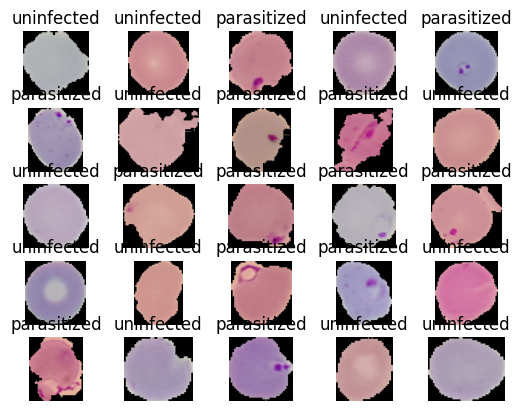

In [218]:
for i , (image,label) in enumerate(train_dataset.take(25)):
    ax = plt.subplot(5,5,i+1) # 4 rows and 4 columns cause we want to display 16 images
    plt.imshow(image)
    plt.title(dataset_info.features['label'].int2str(label)) # label is an integer so we convert it to a string (P or U)
    plt.axis('off') # turn off the axis of the plot (x and y axis)

In [219]:
dataset_info.features['label'].int2str(0) 

'parasitized'

# DATA PROCESSING

We gonna work on two parts here
* resizing the input image size ( converting 102*102 to fixed size so that all images irrespective of H & W will have same H & W (here it's 224))
* normalization,standardization
* x = x-u/s.d  standardization
* x = x - xmin/xmax-xmin  normalization ... in this case we are gonna use normalization

In [220]:
IM_SIZE = 224
def resize_rescale(image,label):
    return tf.image.resize(image,(IM_SIZE,IM_SIZE))/225.0,label
    

In [221]:
train_dataset = train_dataset.map(resize_rescale) # for preprocessing , how exactly? it applies a function to each element of the dataset
val_dataset = val_dataset.map(resize_rescale) 
test_dataset = test_dataset.map(resize_rescale) 

In [222]:
for image,label in train_dataset.take(6):
    print(image.shape)

(224, 224, 3)
(224, 224, 3)
(224, 224, 3)
(224, 224, 3)
(224, 224, 3)
(224, 224, 3)


now we gonna suffle our data, we gonna put them in batches and then we'll do prefetching

In [223]:
#preprocessing train,validation and test dataset
train_dataset = train_dataset.shuffle(buffer_size=8,reshuffle_each_iteration=True).batch(32).prefetch(tf.data.AUTOTUNE)


In [224]:
val_dataset = val_dataset.shuffle(buffer_size=8,reshuffle_each_iteration=True).batch(32).prefetch(tf.data.AUTOTUNE)

In [225]:
val_dataset

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int64, name=None))>

# HOW AND WHY CONVNETS WORK

In [234]:
# we use sequential api which we have bilt previously in car price prediction model
IM_SIZE =224
lenet_model = tf.keras.Sequential([
    InputLayer(input_shape = (IM_SIZE,IM_SIZE,3)),
    Conv2D(
        filters = 6,
        kernel_size = 5,
        strides=(1,1),
        padding ='valid',
        activation = 'relu'  
    ),
    BatchNormalization(),
    MaxPool2D(
        pool_size = 2,
        strides = 2
    ),

    Conv2D(
        filters = 16,
        kernel_size = 5,
        strides=(1,1),
        padding ='valid',
        activation = 'relu'  
    ),
    BatchNormalization(),
    MaxPool2D(
        pool_size = 2,
        strides = 2
    ),

    Flatten(),

    Dense(100,activation="relu"),
    BatchNormalization(),
    
    Dense(10,activation="relu"), #sigmoid makes sure that the output lies between 0 and 1
    BatchNormalization(),
    Dense(1,activation="sigmoid"), #when we had Dense(2,acti..) we are having output.shape = 2 meaning output can be 2 numbs but we want it to be either among 1 or 0 i.e we want output.shape =1
    # when output = 0=> parasitized  & when output = 1 => uninfected
])

c:\Users\chaga\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\layers\core\input_layer.py:25: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(


In [235]:
lenet_model.summary() #we used LeNet architecture ,so this is in no way we use models today
#so in the correction segment we are going to use even better models

Model: "sequential_19"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_34 (Conv2D)              │ (None, 220, 220, 6)    │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 220, 220, 6)    │            24 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_34 (MaxPooling2D) │ (None, 110, 110, 6)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_35 (Conv2D)              │ (None, 106, 106, 16)   │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 106, 106, 16)   │            64 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_35 (MaxPooling2D) │ (None, 53, 53, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_16 (Flatten)            │ (None, 44944)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_60 (Dense)                │ (None, 100)            │     4,494,500 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 100)            │           400 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_61 (Dense)                │ (None, 10)             │         1,010 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 10)             │            40 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_62 (Dense)                │ (None, 1)              │            11 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,498,921 (17.16 MB)

 Trainable params: 4,498,657 (17.16 MB)

 Non-trainable params: 264 (1.03 KB)

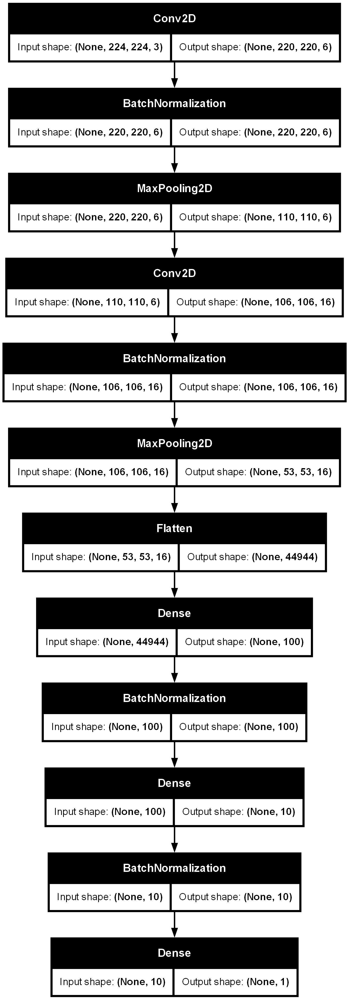

In [236]:
tf.keras.utils.plot_model(lenet_model, to_file="model.png" , show_shapes=True)

# BINARY CROSSENTROPY LOSS

In [237]:
# Let'a move on to error sacntioning section
# For error sactioning binary classification problems,we generally use binary cross entropy loss


In [238]:
y_true = tf.constant([0,1,0,0])
y_pred = tf.constant([0.6,0.51,0.94,0])
bce = tf.keras.losses.BinaryCrossentropy()
#if we are not sure that our output will fall under the range 0 to 1
#then we should put BinaryCrossentropy(from_logits = True).
# but if we are sure that output lies between 0 to 1 (i.e due to sigmoid)
#then we should put BinaryCrossentropy(from_logits = False).
bce(y_true,y_pred)

<tf.Tensor: shape=(), dtype=float32, numpy=1.1007615>

In [240]:
lenet_model.compile(
    optimizer=Adam(learning_rate = 0.01),
    loss = BinaryCrossentropy(),
    metrics = ['accuracy']
)

# TRAINING COVNETS

In [241]:
history = lenet_model.fit(train_dataset,validation_data=val_dataset,epochs=100,verbose=1)
#if the training went well till the end of the epoch but at the end it faced error
# then most likely th error is due to validation_data
#update:fixed the error, missed preprocessing validation and test dataset 

Epoch 1/100


689/689 ━━━━━━━━━━━━━━━━━━━━ 104s 148ms/step - accuracy: 0.6759 - loss: 0.5889 - val_accuracy: 0.7942 - val_loss: 0.7502
Epoch 2/100
689/689 ━━━━━━━━━━━━━━━━━━━━ 103s 149ms/step - accuracy: 0.9309 - loss: 0.1971 - val_accuracy: 0.9474 - val_loss: 0.1546
Epoch 3/100
689/689 ━━━━━━━━━━━━━━━━━━━━ 109s 158ms/step - accuracy: 0.9448 - loss: 0.1612 - val_accuracy: 0.9441 - val_loss: 0.1927
Epoch 4/100
689/689 ━━━━━━━━━━━━━━━━━━━━ 102s 147ms/step - accuracy: 0.9439 - loss: 0.1642 - val_accuracy: 0.9310 - val_loss: 0.2554
Epoch 5/100
689/689 ━━━━━━━━━━━━━━━━━━━━ 104s 151ms/step - accuracy: 0.9423 - loss: 0.1700 - val_accuracy: 0.9441 - val_loss: 0.1658
Epoch 6/100
689/689 ━━━━━━━━━━━━━━━━━━━━ 107s 155ms/step - accuracy: 0.9505 - loss: 0.1420 - val_accuracy: 0.9485 - val_loss: 0.1631
Epoch 7/100
689/689 ━━━━━━━━━━━━━━━━━━━━ 109s 158ms/step - accuracy: 0.9597 - loss: 0.1216 - val_accuracy: 0.9470 - val_loss: 0.1796
Epoch 8/100
689/689 ━━━━━━━━━━━━━━━━━━━━ 100s 145ms/step - accuracy: 0.9637 - los

In [244]:
#here the loss wasn't changing when and for validation it's kind of similar situation
# but once we add batchNormalization and we see loss which drops normally => shows how imp it is to work with batch normalization layer 
#apart from this batchNormalization layer works as a regularizer  

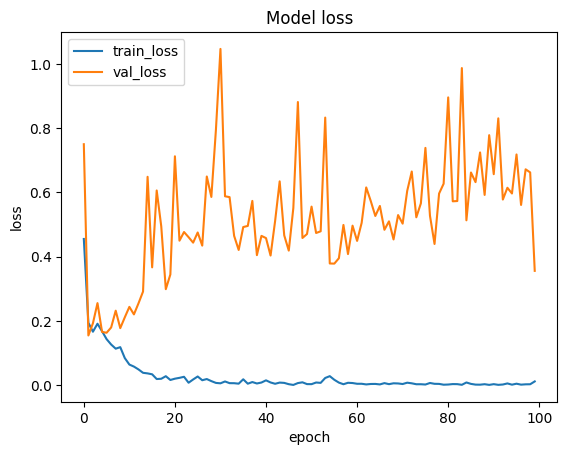

In [245]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train_loss','val_loss'])
plt.show()



In [251]:
test_dataset = test_dataset.batch(1)

In [253]:
lenet_model.evaluate(test_dataset)

2756/2756 ━━━━━━━━━━━━━━━━━━━━ 27s 9ms/step - accuracy: 0.9493 - loss: 0.4019


[0.3901224434375763, 0.9452104568481445]

In [258]:
lenet_model.predict(test_dataset.take(1))

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


array([[6.6826965e-06]], dtype=float32)

In [259]:
def parasite_or_not(x):
    if x<0.5:
        return str('Parasitized')
    else:
        return str('Uninfected')

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step


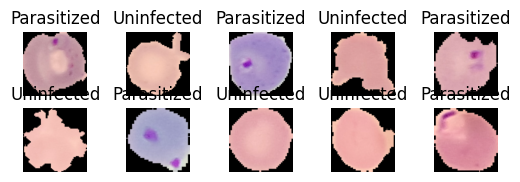

In [260]:
for i, (image,label) in enumerate(test_dataset.take(10)):
    ax = plt.subplot(5,5,i+1)
    plt.imshow(image[0])
    plt.title(parasite_or_not(lenet_model.predict(image)[0][0]))
    plt.axis('off')